<a href="https://colab.research.google.com/github/Mmengyw/Capstone-Project/blob/main/Depth_Prediction_Experiment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importation



In [1]:
# Tensorflow
import tensorflow.compat.v1 as tf
print(tf.__version__)

# I/O libraries
import os
from io import BytesIO
import tarfile
import tempfile
from six.moves import urllib

# Helper libraries
import matplotlib
import torch
from matplotlib import gridspec
from matplotlib import pyplot as plt
import numpy as np
from PIL import Image
import cv2 as cv
from tqdm import tqdm
import IPython
from sklearn.metrics import confusion_matrix
from tabulate import tabulate

# Comment this out if you want to see Deprecation warnings
import warnings
warnings.simplefilter("ignore", DeprecationWarning)

!git clone https://github.com/Mmengyw/Capstone-Project.git
os.chdir("Capstone-Project/opencv-semantic-segmentation/opencv-semantic-segmentation/videos")
!ls

2.7.0
Cloning into 'Capstone-Project'...
remote: Enumerating objects: 253, done.
remote: Counting objects: 100% (253/253), done.
remote: Compressing objects: 100% (238/238), done.
remote: Total 253 (delta 67), reused 25 (delta 2), pack-reused 0
Receiving objects: 100% (253/253), 593.15 MiB | 26.14 MiB/s, done.
Resolving deltas: 100% (67/67), done.
Checking out files: 100% (68/68), done.
massachusetts.mp4  test12.mp4


In [2]:
pip install timm

     |████████████████████████████████| 376 kB 9.7 MB/s 


In [3]:
#model_type = "DPT_Large"     # MiDaS v3 - Large     (highest accuracy, slowest inference speed)
model_type = "DPT_Hybrid"   # MiDaS v3 - Hybrid    (medium accuracy, medium inference speed)
#model_type = "MiDaS_small"  # MiDaS v2.1 - Small   (lowest accuracy, highest inference speed)

midas = torch.hub.load("intel-isl/MiDaS", model_type)

Downloading: "https://github.com/intel-isl/MiDaS/archive/master.zip" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/intel-isl/DPT/releases/download/1_0/dpt_hybrid-midas-501f0c75.pt" to /root/.cache/torch/hub/checkpoints/dpt_hybrid-midas-501f0c75.pt


  0%|          | 0.00/470M [00:00<?, ?B/s]

#[link text](https://)# MIT Driving Scene Segmentation




In [4]:
class DeepLabModel(object):
    """Class to load deeplab model and run inference."""

    FROZEN_GRAPH_NAME = 'frozen_inference_graph'

    def __init__(self, tarball_path):
        """Creates and loads pretrained deeplab model."""
        self.graph = tf.Graph()
        graph_def = None

        # Extract frozen graph from tar archive.
        tar_file = tarfile.open(tarball_path)
        for tar_info in tar_file.getmembers():
            if self.FROZEN_GRAPH_NAME in os.path.basename(tar_info.name):
                file_handle = tar_file.extractfile(tar_info)
                graph_def = tf.GraphDef.FromString(file_handle.read())
                break
        tar_file.close()

        if graph_def is None:
            raise RuntimeError('Cannot find inference graph in tar archive.')

        with self.graph.as_default():
            tf.import_graph_def(graph_def, name='')
        self.sess = tf.Session(graph=self.graph)

    def run(self, image, INPUT_TENSOR_NAME = 'ImageTensor:0', OUTPUT_TENSOR_NAME = 'SemanticPredictions:0'):
        """Runs inference on a single image.

        Args:
            image: A PIL.Image object, raw input image.
            INPUT_TENSOR_NAME: The name of input tensor, default to ImageTensor.
            OUTPUT_TENSOR_NAME: The name of output tensor, default to SemanticPredictions.

        Returns:
            resized_image: RGB image resized from original input image.
            seg_map: Segmentation map of `resized_image`.
        """
        width, height = image.size
        target_size = (2049,1025)  # size of Cityscapes images
        resized_image = image.convert('RGB').resize(target_size, Image.ANTIALIAS)
        batch_seg_map = self.sess.run(
            OUTPUT_TENSOR_NAME,
            feed_dict={INPUT_TENSOR_NAME: [np.asarray(resized_image)]})
        seg_map = batch_seg_map[0]  # expected batch size = 1
        if len(seg_map.shape) == 2:
            seg_map = np.expand_dims(seg_map,-1)  # need an extra dimension for cv.resize
        seg_map = cv.resize(seg_map, (width,height), interpolation=cv.INTER_NEAREST)
        return seg_map

In [5]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
midas.to(device)
midas.eval()

DPTDepthModel(
  (pretrained): Module(
    (model): VisionTransformer(
      (patch_embed): HybridEmbed(
        (backbone): ResNetV2(
          (stem): Sequential(
            (conv): StdConv2dSame(3, 64, kernel_size=(7, 7), stride=(2, 2), bias=False)
            (norm): GroupNormAct(
              32, 64, eps=1e-05, affine=True
              (act): ReLU(inplace=True)
            )
            (pool): MaxPool2dSame(kernel_size=(3, 3), stride=(2, 2), padding=(0, 0), dilation=(1, 1), ceil_mode=False)
          )
          (stages): Sequential(
            (0): ResNetStage(
              (blocks): Sequential(
                (0): Bottleneck(
                  (downsample): DownsampleConv(
                    (conv): StdConv2dSame(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
                    (norm): GroupNormAct(
                      32, 256, eps=1e-05, affine=True
                      (act): Identity()
                    )
                  )
                  (conv1): S

In [6]:
midas_transforms = torch.hub.load("intel-isl/MiDaS", "transforms")

if model_type == "DPT_Large" or model_type == "DPT_Hybrid":
    transform = midas_transforms.dpt_transform
else:
    transform = midas_transforms.small_transform

Using cache found in /root/.cache/torch/hub/intel-isl_MiDaS_master


### Visualization
Now let's create some helper functions for decoding and visualizing the results.

In [7]:
def create_label_colormap():
    """Creates a label colormap used in Cityscapes segmentation benchmark.

    Returns:
        A Colormap for visualizing segmentation results.
    """
    colormap = np.array([
        [128,  64, 128],
        [244,  35, 232],
        [ 70,  70,  70],
        [102, 102, 156],
        [190, 153, 153],
        [153, 153, 153],
        [250, 170,  30],
        [220, 220,   0],
        [107, 142,  35],
        [152, 251, 152],
        [ 70, 130, 180],
        [220,  20,  60],
        [255,   0,   0],
        [  0,   0, 142],
        [  0,   0,  70],
        [  0,  60, 100],
        [  0,  80, 100],
        [  0,   0, 230],
        [119,  11,  32],
        [  0,   0,   0]], dtype=np.uint8)
    return colormap


def label_to_color_image(label):
    """Adds color defined by the dataset colormap to the label.

    Args:
        label: A 2D array with integer type, storing the segmentation label.

    Returns:
        result: A 2D array with floating type. The element of the array
            is the color indexed by the corresponding element in the input label
            to the PASCAL color map.

    Raises:
        ValueError: If label is not of rank 2 or its value is larger than color
            map maximum entry.
    """
    if label.ndim != 2:
        raise ValueError('Expect 2-D input label')

    colormap = create_label_colormap()

    if np.max(label) >= len(colormap):
        raise ValueError('label value too large.')

    return colormap[label]


def vis_segmentation(image, seg_map):
    """Visualizes input image, segmentation map and overlay view."""
    plt.figure(figsize=(20, 4))
    grid_spec = gridspec.GridSpec(1, 4, width_ratios=[6, 6, 6, 1])

    plt.subplot(grid_spec[0])
    plt.imshow(image)
    plt.axis('off')
    plt.title('input image')

    plt.subplot(grid_spec[1])
    seg_image = label_to_color_image(seg_map).astype(np.uint8)
    plt.imshow(seg_image)
    plt.axis('off')
    plt.title('segmentation map')

    plt.subplot(grid_spec[2])
    plt.imshow(image)
    plt.imshow(seg_image, alpha=0.7)
    plt.axis('off')
    plt.title('segmentation overlay')

    unique_labels = np.unique(seg_map)
    ax = plt.subplot(grid_spec[3])
    plt.imshow(FULL_COLOR_MAP[unique_labels].astype(np.uint8), interpolation='nearest')
    ax.yaxis.tick_right()
    plt.yticks(range(len(unique_labels)), LABEL_NAMES[unique_labels])
    plt.xticks([], [])
    ax.tick_params(width=0.0)
    plt.grid('off')
    plt.show()


LABEL_NAMES = np.asarray([
    'road', 'sidewalk', 'building', 'wall', 'fence', 'pole', 'traffic light',
    'traffic sign', 'vegetation', 'terrain', 'sky', 'person', 'rider', 'car', 'truck',
    'bus', 'train', 'motorcycle', 'bicycle', 'void'])

FULL_LABEL_MAP = np.arange(len(LABEL_NAMES)).reshape(len(LABEL_NAMES), 1)
FULL_COLOR_MAP = label_to_color_image(FULL_LABEL_MAP)

!/usr/local/cuda/bin/nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0


### Load the model from a frozen graph
There are two model checkpoints pre-trained on Cityscapes with different network backbones: MobileNetV2 and Xception65. We default to use MobileNetV2 for faster inference.

In [8]:
MODEL_NAME = 'mobilenetv2_coco_cityscapes_trainfine'
#MODEL_NAME = 'xception65_cityscapes_trainfine'

_DOWNLOAD_URL_PREFIX = 'http://download.tensorflow.org/models/'
_MODEL_URLS = {
    'mobilenetv2_coco_cityscapes_trainfine':
        'deeplabv3_mnv2_cityscapes_train_2018_02_05.tar.gz',
    'xception65_cityscapes_trainfine':
        'deeplabv3_cityscapes_train_2018_02_06.tar.gz',
}
_TARBALL_NAME = 'deeplab_model.tar.gz'

model_dir = tempfile.mkdtemp()
tf.gfile.MakeDirs(model_dir)

download_path = os.path.join(model_dir, _TARBALL_NAME)
print('downloading model, this might take a while...')
urllib.request.urlretrieve(_DOWNLOAD_URL_PREFIX + _MODEL_URLS[MODEL_NAME], download_path)
print('download completed! loading DeepLab model...')

MODEL = DeepLabModel(download_path)
print('model loaded successfully!')

downloading model, this might take a while...
download completed! loading DeepLab model...
model loaded successfully!


### Run on the sample image
The sample image is frame #0 in the MIT Driving Scene Segmentation (DriveSeg) Dataset.

In [9]:
from PIL import Image
img=np.zeros((512,512,3))
for j in range (512):
  for i in range (512):
    img[i,j]=[i%256,j%256,(j+i)%256]
img_test = Image.fromarray(img, 'RGB')
img_test.show()

In [10]:
def conv(tensor):
  array=tensor.cpu().numpy()
  lrow,lcol=np.shape(array)
  for i in range(lrow):
    for j in range(lcol):
      array[i,j]=conv_spline(array[i,j])
  return array


def conv_spline(val):
  if val<=2:
    return(200)
  elif 2<=val and val<=27:
    return(-8*val+219)
  elif val>=27:
    return ((-2*val/15) +6.6)

running deeplab on the sample image...


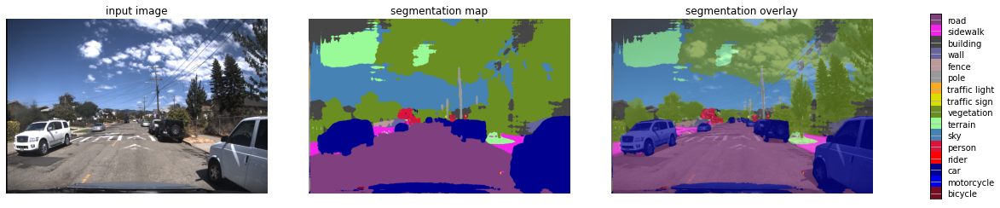

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


prediction=
tensor([[[1752.7648, 1748.5876, 1702.7457,  ...,  997.8768,  996.1188,
           795.1492],
         [1809.2971, 1775.0486, 1722.4437,  ...,  996.7743,  988.3679,
           995.8779],
         [1878.6176, 1831.3212, 1782.7676,  ...,  996.2971,  996.0609,
           994.2576],
         ...,
         [2386.2031, 2402.1831, 2406.5769,  ..., 3078.7053, 3077.2373,
          3081.9807],
         [2402.2615, 2411.6438, 2422.2910,  ..., 3072.3916, 3085.2004,
          3078.7581],
         [2393.4148, 2416.6072, 2422.0449,  ..., 3086.2192, 3087.1770,
          3085.6416]]], device='cuda:0')


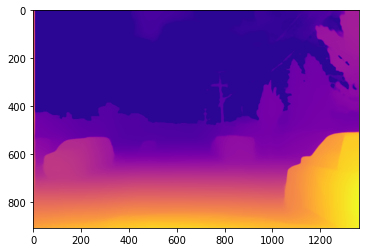

In [11]:
from PIL import Image

SAMPLE_IMAGE = urllib.request.urlretrieve('https://raw.githubusercontent.com/Mmengyw/Capstone-Project/main/opencv-semantic-segmentation/opencv-semantic-segmentation/images/sample%20image.PNG')[0]
print('running deeplab on the sample image...')

      # import a sample image 

def run_visualization(SAMPLE_IMAGE):
    """Inferences DeepLab model and visualizes result."""
    original_im = Image.open(SAMPLE_IMAGE)
    seg_map = MODEL.run(original_im)
    vis_segmentation(original_im, seg_map)

run_visualization(SAMPLE_IMAGE)   #print input image, segmentation map, segmentation overlay

img = cv.imread(SAMPLE_IMAGE)
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
img_test = Image.fromarray(img, 'RGB')
img_test.show()

# print('image=',img)       #img contains value between 0 and 255 RGB
# print('image shape=',np.shape(img))

input_batch = transform(img).to(device)   #prepare the img for depth prediction, application of a kernel ?
# print('input_batch shape=',np.shape(input_batch))
# print('input_batch=')
# print(input_batch)
with torch.no_grad():
    prediction = midas(input_batch)
    # print('prediction shape=',np.shape(prediction),type(prediction))
    print('prediction=')
    print(prediction)
    #print(torch.max(prediction),torch.min(prediction))

    # print(prediction[0,337,444])
    # print(prediction[0,84,507])
    # print(prediction[0,10,444])

    prediction = torch.nn.functional.interpolate(
        prediction.unsqueeze(1),
        size=img.shape[:2],
        mode="bicubic",
        align_corners=False,
    ).squeeze()
prediction2=prediction
output=prediction.cpu().numpy()

plt.imshow(output, cmap='plasma')

In [12]:
print('prediction shape=',np.shape(prediction),type(prediction))
print('prediction=')
print(prediction)
print(torch.max(prediction),torch.min(prediction))

print(prediction[800,700])
print(prediction[700,1100])

print(prediction[10,800])
print(prediction[150,1200])

prediction shape= torch.Size([909, 1362]) <class 'torch.Tensor'>
prediction=
tensor([[1746.6678, 1747.0004, 1750.7239,  ...,  899.3510,  798.4539,
          748.6416],
        [1759.1290, 1758.0270, 1758.9478,  ...,  917.5917,  837.7722,
          798.3062],
        [1779.6223, 1775.8091, 1771.4659,  ...,  954.3079,  917.6018,
          899.2809],
        ...,
        [2398.4341, 2401.6101, 2407.4363,  ..., 3085.4480, 3082.1572,
         3080.8367],
        [2392.2332, 2396.9629, 2406.1355,  ..., 3086.3342, 3085.1096,
         3084.5869],
        [2389.7390, 2395.1826, 2405.8853,  ..., 3086.9238, 3086.5046,
         3086.2859]], device='cuda:0')
tensor(3147.8052, device='cuda:0') tensor(-178.1076, device='cuda:0')
tensor(1963.1803, device='cuda:0')
tensor(2233.9333, device='cuda:0')
tensor(0., device='cuda:0')
tensor(59.6367, device='cuda:0')


[[ 0.00000000e+00 -1.10132159e+07 -2.20264317e+07 ... -9.97797357e+09
  -9.98898678e+09 -1.00000000e+10]
 [ 0.00000000e+00 -1.10132159e+07 -2.20264317e+07 ... -9.97797357e+09
  -9.98898678e+09 -1.00000000e+10]
 [ 0.00000000e+00 -1.10132159e+07 -2.20264317e+07 ... -9.97797357e+09
  -9.98898678e+09 -1.00000000e+10]
 ...
 [ 0.00000000e+00 -1.10132159e+07 -2.20264317e+07 ... -9.97797357e+09
  -9.98898678e+09 -1.00000000e+10]
 [ 0.00000000e+00 -1.10132159e+07 -2.20264317e+07 ... -9.97797357e+09
  -9.98898678e+09 -1.00000000e+10]
 [ 0.00000000e+00 -1.10132159e+07 -2.20264317e+07 ... -9.97797357e+09
  -9.98898678e+09 -1.00000000e+10]]


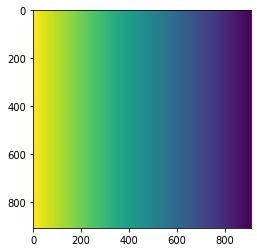

In [13]:
h=909
L=1362
test_array= np.full((h,h),np.linspace(0,-10000000000,h))
print(test_array)
plt.imshow(test_array)

# Test

In [14]:
nb_photo=34

equiv=np.array([])
equiv=np.concatenate(([[0.01,50]],    #for extrapolation
                      [[0.1,45]],     #premier plan
                      [[0.9,42.3]],
                      [[1.8,37.4]],
                      [[2.7,28.7]],
                      [[3.6,24.443365]],
                      [[4.5,22.058018]],
                      [[5.4,15.317413]],
                      [[6.3,14.677493]],
                      [[7.2,10.969739]],
                      [[8.1,10.883035]],
                      [[9,9.883035]],
                      [[9.9,8.058806]],
                      [[10.8,7.5158963]],
                      [[11.7,7.098169]],
                      [[12.6,6.111024]],
                      [[13.5,5.6323136]],
                      [[14.4,5.2216917]],
                      [[15.3,5]],
                      [[16.2,4.9529667]],
                      [[17.1,4.8]],
                      [[18,4.7]],
                      [[18.9,4.6]],
                      [[19.8,4.5]],
                      [[20.7,4.4]],
                      [[21.6,4.3]],
                      [[22.5,4.2]],
                      [[23.4,4.1]],
                      [[24.3,4]],
                      [[25.2,3.9]],
                      [[26.1,3.8]],
                      [[27,3.7]],
                      [[27.9,3.6]],
                      [[28.8,3.5]],
                      [[29.7,3.2]],
                      [[30.6,3]],
                      [[50,0.5]],
                      [[100,0]],    #horizon
                      [[200,-5]])   #for extrapolation
                      )
for i in range (len(equiv)):
  print(equiv[i,0],equiv[i,1])

0.01 50.0
0.1 45.0
0.9 42.3
1.8 37.4
2.7 28.7
3.6 24.443365
4.5 22.058018
5.4 15.317413
6.3 14.677493
7.2 10.969739
8.1 10.883035
9.0 9.883035
9.9 8.058806
10.8 7.5158963
11.7 7.098169
12.6 6.111024
13.5 5.6323136
14.4 5.2216917
15.3 5.0
16.2 4.9529667
17.1 4.8
18.0 4.7
18.9 4.6
19.8 4.5
20.7 4.4
21.6 4.3
22.5 4.2
23.4 4.1
24.3 4.0
25.2 3.9
26.1 3.8
27.0 3.7
27.9 3.6
28.8 3.5
29.7 3.2
30.6 3.0
50.0 0.5
100.0 0.0
200.0 -5.0


100.0


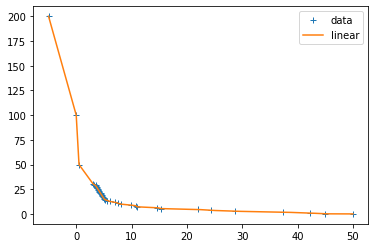

In [15]:
import numpy as np
import scipy as sp
from scipy.interpolate import Rbf, InterpolatedUnivariateSpline

X = equiv[:,1]
Y=equiv[:,0]

X=np.flip(X)      #inverse les listes
Y=np.flip(Y)

new_length = 25
new_x = np.linspace(X.min(), X.max(), new_length)
f=sp.interpolate.interp1d(X, Y, kind='linear')


print(f(0))
xnew = np.linspace(-5, 50,1000)

plt.plot(X, Y, '+', xnew, f(xnew), '-')

plt.legend(['data', 'linear'], loc = 'best')

plt.show()

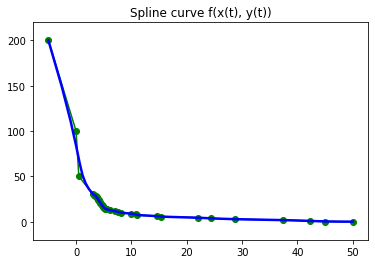

In [16]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.interpolate as si

def getControlPoints(knots, k):
    n = len(knots) - 1 - k
    cx = np.zeros(n)
    for i in range(n):
        tsum = 0
        for j in range(1, k+1):
            tsum += knots[i+j]
        cx[i] = float(tsum)/k
    return cx

#####  CONTROL POINTS   #####

x = X
y = Y

xmin, xmax = min(x), max(x) 
ymin, ymax = min(y), max(y)

n = len(x)
plotpoints = 100

#####  PARAMETRIC SPLINE REPRESENTATION  #####

k = 3
knotspace = range(n)

# find knot vector 
knots = si.InterpolatedUnivariateSpline(knotspace,knotspace,k=k).get_knots()
knots_full = np.concatenate(([knots[0]]*k, knots, [knots[-1]]*k))

# define tuples of knot vector, coefficient vector (control points coordinates) and spline degree
tckX = knots_full, x, k
tckY = knots_full, y, k

# construct spline functions
splineX = si.UnivariateSpline._from_tck(tckX)
splineY = si.UnivariateSpline._from_tck(tckY)

# evaluate spline points
tP = np.linspace(knotspace[0], knotspace[-1], plotpoints)
xP = splineX(tP)
yP = splineY(tP)

# define coordinates of spline control points in knot space
cp = getControlPoints(knots_full, k)

#####  PLOT  #####

offset_x = (xmax - xmin)*0.05
offset_y = (ymax - ymin)*0.1
knotpoints_y = [ymin-offset_y*0.5]*len(knots_full)
knotpoints_x = [xmin-offset_x*0.5]*len(knots_full)

fig = plt.figure()

# ax = fig.add_subplot(224)
# ax.grid(True)
# plt.plot(x, cp, '-og')
# plt.plot(xP, tP, 'r', lw=2)
# plt.plot(knotpoints_x, knots_full, '>', ms=6, color='black')
# plt.ylim([knotspace[0] - offset_y, knotspace[-1] + offset_y])
# plt.xlim([xmin - offset_x, xmax + offset_x])
# plt.ylabel('t', rotation=0,  labelpad=20, fontweight='bold', fontsize=14) # position=(1.0,0)
# plt.xlabel('x', labelpad=10, fontweight='bold', fontsize=14) # position=(1.0,0)
# ax.invert_yaxis()
# plt.title('Spline function x(t)')

# ax = fig.add_subplot(221)
# ax.grid(True)
# plt.plot(cp, y, '-og')
# plt.plot(tP, yP, 'r', lw=2)
# plt.plot(knots_full,knotpoints_y, '^', ms=6, color='black')
# plt.xlim([knotspace[0] - offset_x, knotspace[-1] + offset_x])
# plt.ylim([ymin - offset_y, ymax + offset_y])
# plt.ylabel('y', labelpad=10, rotation=0, fontweight='bold', fontsize=14)
# plt.xlabel('t', labelpad=20, fontweight='bold', fontsize=14)  #position=(0,0)
# ax.invert_xaxis()
# plt.title('Spline function y(t)')

# ax = fig.add_subplot(222)
# ax.grid(True)
plt.plot(x, y, '-og')
plt.plot(xP, yP, 'b', lw=2.5)
plt.xlim([xmin - offset_x, xmax + offset_x])
plt.ylim([ymin - offset_y, ymax + offset_y])
plt.title('Spline curve f(x(t), y(t))')

plt.show()

**Expand**

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


[[24.969797 24.97455  25.02778  ... 12.856831 11.414437 10.702336]
 [25.147936 25.132181 25.145346 ... 13.117594 11.97652  11.412326]
 [25.440903 25.386389 25.324303 ... 13.642476 13.117738 12.855827]
 ...
 [34.287235 34.332638 34.415928 ... 44.108562 44.06152  44.04264 ]
 [34.19859  34.2662   34.39733  ... 44.121235 44.103725 44.096252]
 [34.162933 34.240753 34.393753 ... 44.12966  44.123665 44.120537]]
45.0
[[3.48869402 3.48768905 3.47643432 ... 6.74193767 7.09205636 8.26262882]
 [3.45102933 3.45436042 3.45157698 ... 6.67864144 6.95561957 7.09256888]
 [3.38908599 3.40061213 3.41373928 ... 6.55123437 6.67860648 6.7421812 ]
 ...
 [2.12201015 2.11731333 2.10869712 ... 0.36412964 0.37806826 0.38366202]
 [2.13118041 2.1241861  2.11062091 ... 0.36037485 0.36556283 0.36777705]
 [2.13486896 2.12681864 2.11099106 ... 0.35787806 0.35965486 0.36058169]]


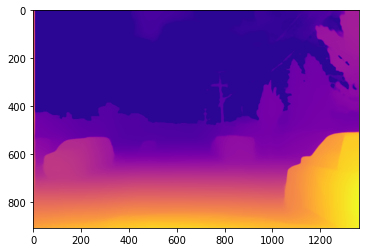

In [17]:
from PIL import Image
from google.colab import files
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# img = cv2.imread('/content/IMG_9803.png') # reads image
# print(img)
# cv2_imshow(img)
# #plt.imshow(img)
# plt.imshow(np.asarray(img))

#SAMPLE_IMAGE = urllib.request.urlretrieve('https://raw.githubusercontent.com/Mmengyw/Capstone-Project/main/Test_Distance_Midas/IMG_9830.png')[0]
SAMPLE_IMAGE = urllib.request.urlretrieve('https://raw.githubusercontent.com/Mmengyw/Capstone-Project/main/opencv-semantic-segmentation/opencv-semantic-segmentation/images/sample%20image.PNG')[0]

#print('running deeplab on the sample image...')

      # import a sample image 
'''
def run_visualization(SAMPLE_IMAGE):
    """Inferences DeepLab model and visualizes result."""
    original_im = Image.open(SAMPLE_IMAGE)
    seg_map = MODEL.run(original_im)
    vis_segmentation(original_im, seg_map)

run_visualization(SAMPLE_IMAGE)   #print input image, segmentation map, segmentation overlay
'''

img = cv.imread(SAMPLE_IMAGE)
#print(img)
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
img_test = Image.fromarray(img, 'RGB')
img_test.show()

# print('image=',img)       #img contains value between 0 and 255 RGB
# print('image shape=',np.shape(img))

input_batch = transform(img).to(device)   #prepare the img for depth prediction, application of a kernel ?
# print('input_batch shape=',np.shape(input_batch))
# print('input_batch=')
# print(input_batch)
with torch.no_grad():
    prediction = midas(input_batch)
    # print('prediction shape=',np.shape(prediction),type(prediction))
    # print('prediction=')
    # print(prediction)
    #print(torch.max(prediction),torch.min(prediction))

    # print(prediction[0,337,444])
    # print(prediction[0,84,507])
    # print(prediction[0,10,444])

    prediction = torch.nn.functional.interpolate(
        prediction.unsqueeze(1),
        size=img.shape[:2],
        mode="bicubic",
        align_corners=False,
    ).squeeze()
output=prediction.cpu().numpy()
# original_im = Image.open(SAMPLE_IMAGE)
# seg_map = MODEL.run(original_im)
# vis_segmentation(original_im, seg_map)
#print(output)
#
output=50*output/np.max(output)     #normalization due to the 
print(output)
print(np.max(output))
print(f(output))
plt.imshow(output, cmap='plasma')

# Video


In [18]:
import cv2
import numpy as np
import os

!ls
def vis_segmentation_stream(image, frame, seg_map, index):
    """Visualizes segmentation overlay view and stream it with IPython display."""
    plt.figure(figsize=(12, 7))

    seg_image = label_to_color_image(seg_map).astype(np.uint8)
    plt.imshow(image)
    plt.imshow(seg_image, alpha=0.7)
    plt.axis('off')
    plt.title('segmentation overlay | frame #%d'%index)
    plt.grid('off')
    plt.tight_layout()
    plt.show()
    img = frame
    img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    input_batch = transform(img).to(device)

    with torch.no_grad():
      prediction = midas(input_batch)

      prediction = torch.nn.functional.interpolate(
        prediction.unsqueeze(1),
        size=img.shape[:2],
        mode="bicubic",
        align_corners=False,
      ).squeeze()
    
    depth_out = prediction.cpu().numpy()
    #plt.imshow(output)
    # # Show visualization in a streaming fashion.
    # f = BytesIO()
    # plt.savefig(f, format='jpeg')
    # IPython.display.display(IPython.display.Image(data=f.getvalue()))
    # f.close()
    # plt.close()
    return(seg_image,depth_out)

def run_visualization_video(frame, index, out):
    """Inferences DeepLab model on a video file and stream the visualization."""
    original_im = Image.fromarray(frame[..., ::-1])
    seg_map = MODEL.run(original_im)
    video_rec.write(seg_map)
    #out.write(seg_map)
    #vis_segmentation_stream(original_im, frame, seg_map, index)

SAMPLE_VIDEO = 'test12.mp4'
print('running deeplab on the sample video...')

video = cv2.VideoCapture(SAMPLE_VIDEO)
#num_frames = 598  # uncomment to use the full sample video
num_frames = 3
(width,height)=(1616,1240)
video_rec=cv2.VideoWriter('video_rec.avi',-1,1,(width,height))


# Define the codec and create VideoWriter object
#fourcc = cv2.cv.CV_FOURCC(*'DIVX')
#out = cv2.VideoWriter('output.avi',fourcc, 20.0, (640,480))
image_size = (1616,1240)
fps = 24

out = cv2.VideoWriter('video_rec.mp4', cv2.VideoWriter_fourcc(*'MP4V'), fps, image_size)


img=[]
try:
    for i in range(num_frames):
        _, frame = video.read()
        if not _: break
        run_visualization_video(frame, i, out)
        IPython.display.clear_output(wait=True)
except KeyboardInterrupt:
    plt.close()
    print("Stream stopped.")

while(video_rec.isOpened()):
    ret, frame = video_rec.read()
    if ret==True:
        frame = cv2.flip(frame,0)

        # write the flipped frame
        out.write(frame)

        cv2.imshow('frame',frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

# Release everything if job is finished
cv2.destroyAllWindows()
video_rec.release()
out.release()

massachusetts.mp4  test12.mp4
running deeplab on the sample video...


In [19]:
import cv2
import numpy as np

# Create a VideoCapture object and read from input file
# If the input is the camera, pass 0 instead of the video file name
cap = cv2.VideoCapture('video_rec.mp4')

# Check if camera opened successfully
if (cap.isOpened()== False): 
  print("Error opening video stream or file")

# Read until video is completed
while(cap.isOpened()):
  # Capture frame-by-frame
  ret, frame = cap.read()
  if ret == True:

    # Display the resulting frame
    cv2.imshow('Frame',frame)

    # Press Q on keyboard to  exit
    if cv2.waitKey(25) & 0xFF == ord('q'):
      break

  # Break the loop
  else: 
    break

# When everything done, release the video capture object
cap.release()

# Closes all the frames
cv2.destroyAllWindows()

Error opening video stream or file


In [20]:
!ls
def vis_segmentation_stream(image, frame, seg_map):
    """Visualizes segmentation overlay view and stream it with IPython display."""
    plt.figure(figsize=(12, 7))

    seg_image = label_to_color_image(seg_map).astype(np.uint8)
    plt.imshow(image)
    plt.imshow(seg_image, alpha=0.7)
    plt.axis('off')
    #plt.title('segmentation overlay | frame #%d'%index)
    plt.grid('off')
    plt.tight_layout()
    plt.show()
    img = frame
    img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    input_batch = transform(img).to(device)

    with torch.no_grad():
      prediction = midas(input_batch)

      prediction = torch.nn.functional.interpolate(
        prediction.unsqueeze(1),
        size=img.shape[:2],
        mode="bicubic",
        align_corners=False,
      ).squeeze()
    
    depth_out = prediction.cpu().numpy()
    #plt.imshow(output)
    # # Show visualization in a streaming fashion.
    # f = BytesIO()
    # plt.savefig(f, format='jpeg')
    # IPython.display.display(IPython.display.Image(data=f.getvalue()))
    # f.close()
    # plt.close()
    return(seg_image,depth_out)

massachusetts.mp4  test12.mp4  video_rec.mp4


In [21]:
def run_visualization_video(frame, out):
    """Inferences DeepLab model on a video file and stream the visualization."""
    original_im = Image.fromarray(frame[..., ::-1])
    seg_map = MODEL.run(original_im)
    video_rec.write(seg_map)
    #out.write(seg_map)
    #vis_segmentation_stream(original_im, frame, seg_map, index)

In [22]:
import numpy as np
from PIL import Image
from google.colab import files
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# create VideoCapture object
Video_test=urllib.request.urlretrieve('https://raw.githubusercontent.com/Mmengyw/Capstone-Project/main/opencv-semantic-segmentation/opencv-semantic-segmentation/videos/test12.mp4')[0]
cap = cv2.VideoCapture('test12.mp4')
if (cap.isOpened() == False):
    print('Error while trying to open video. Plese check again...')
# get the frame width and height
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
# define codec and create VideoWriter object
out = cv2.VideoWriter('out_videos.mp4', cv2.VideoWriter_fourcc('M','J','P','G'), 30, (frame_width, frame_height))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


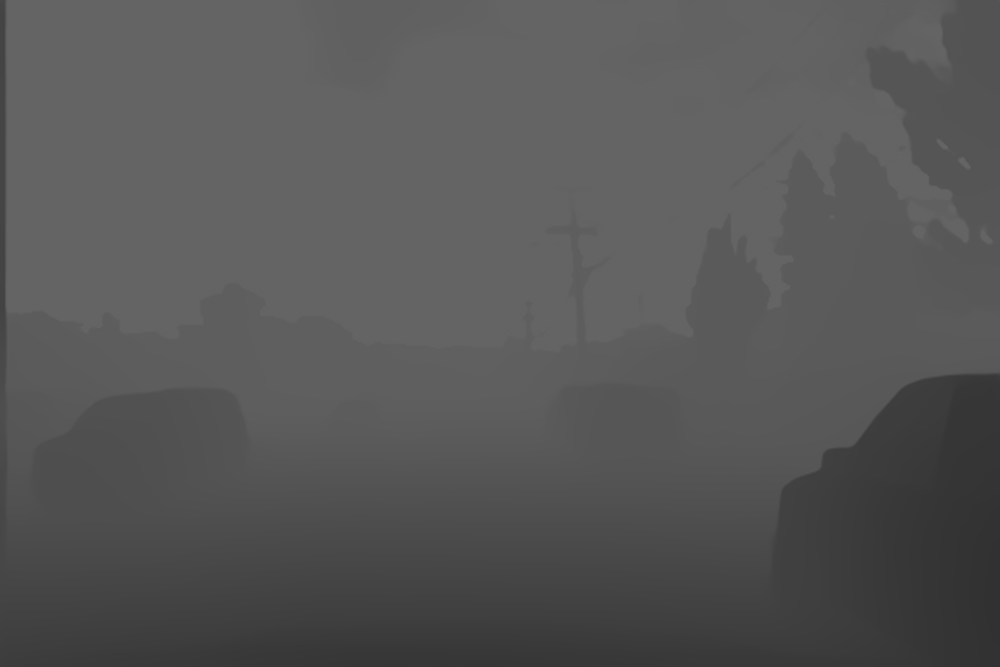

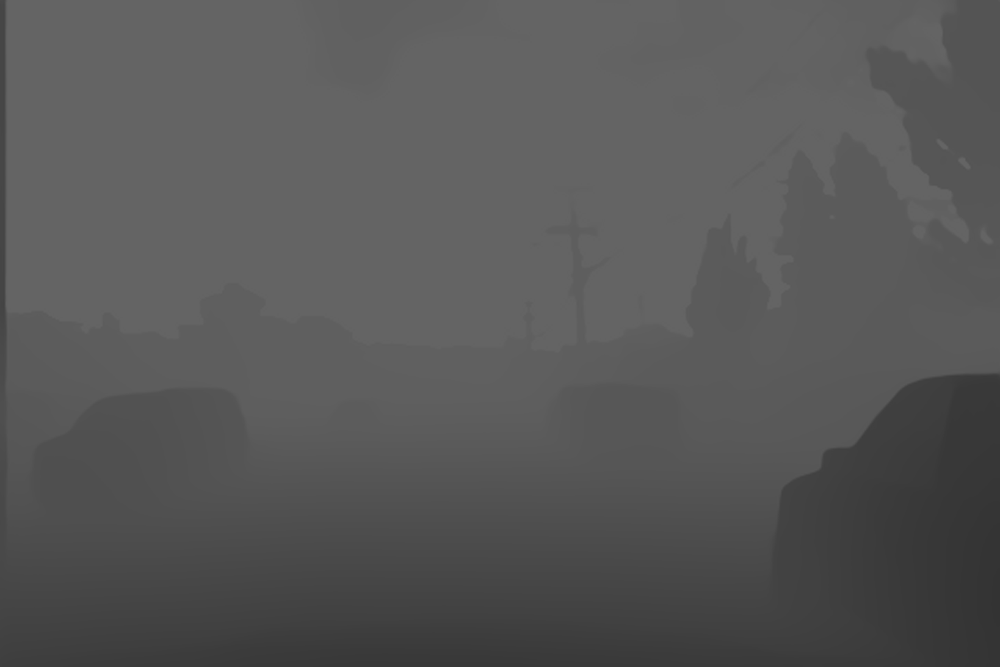

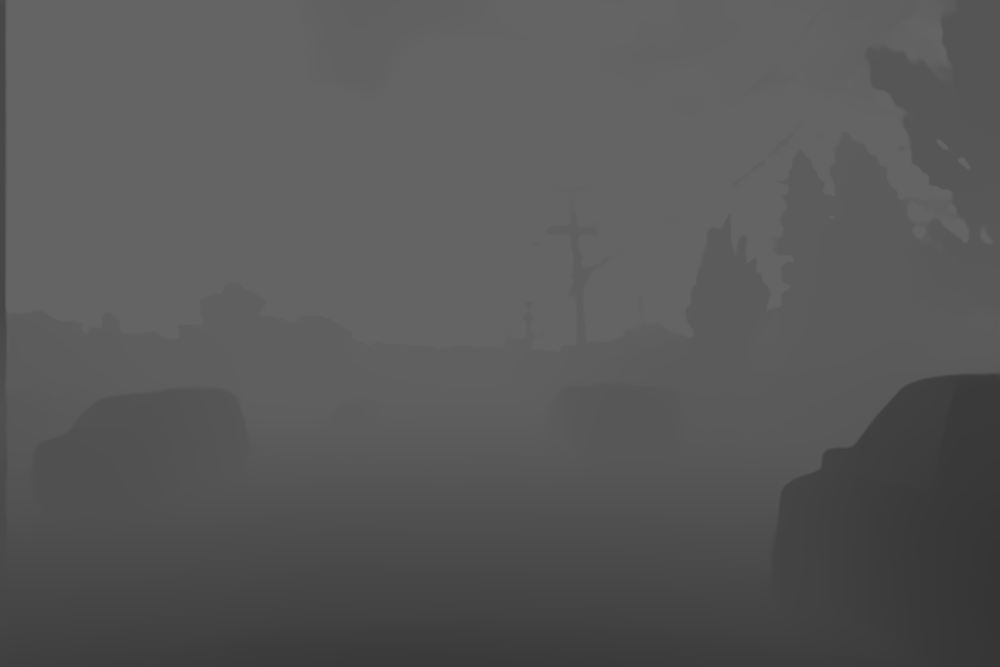

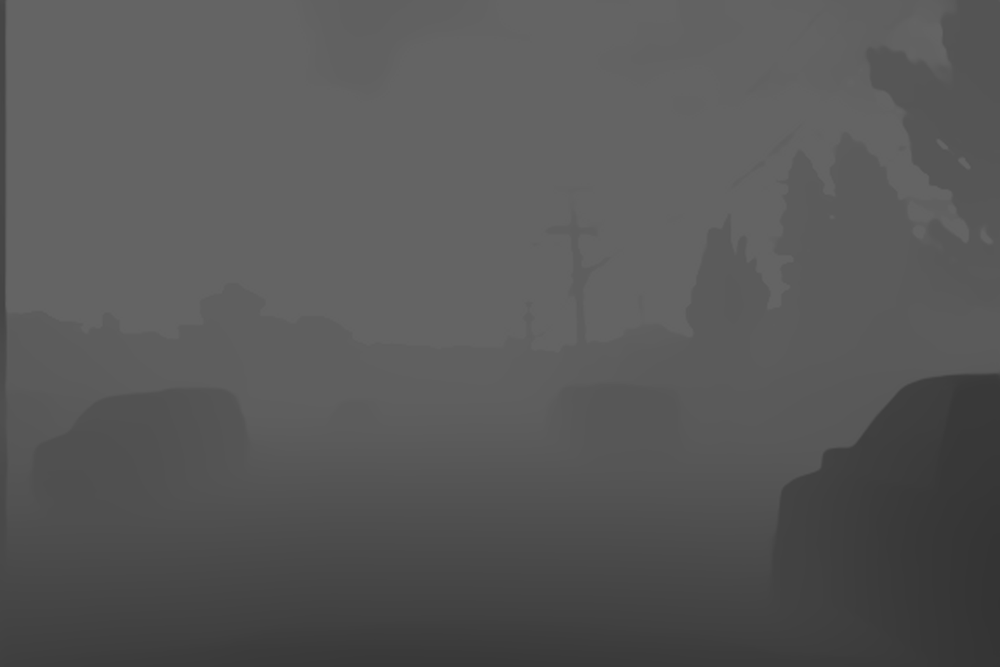

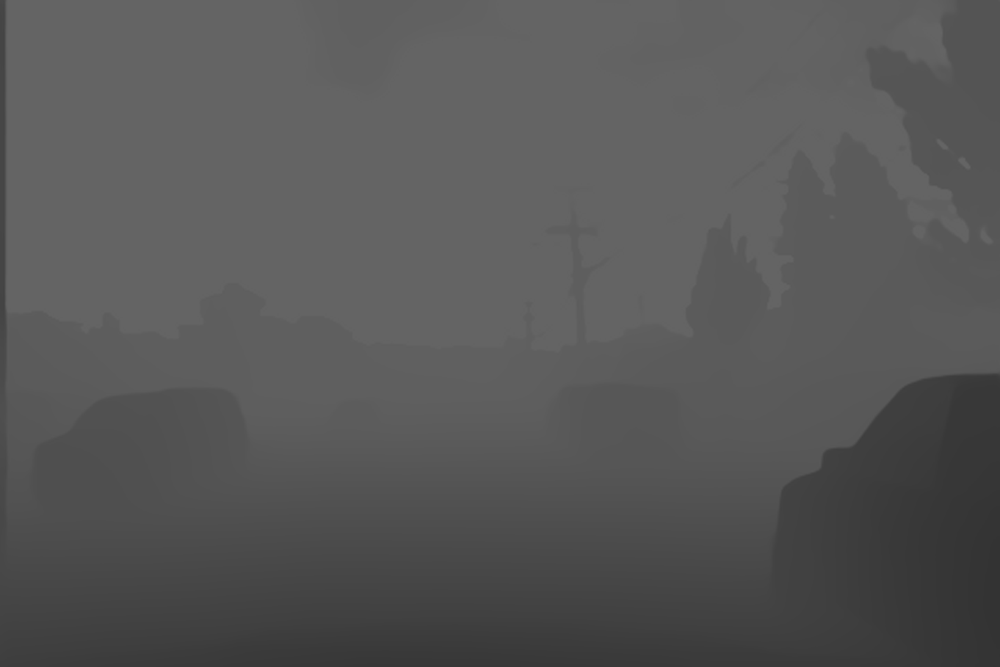

...

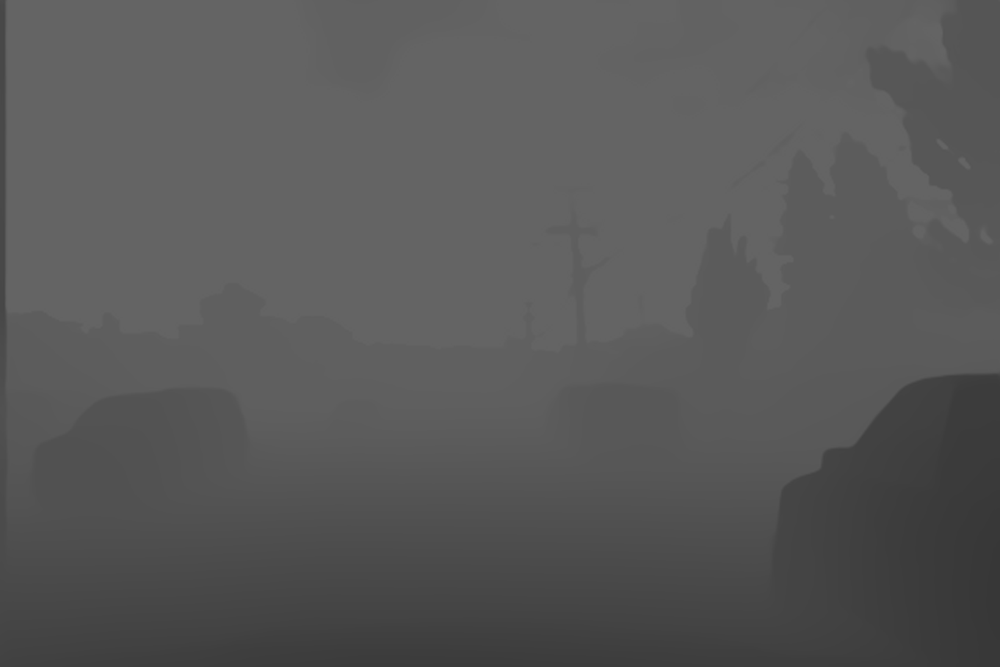

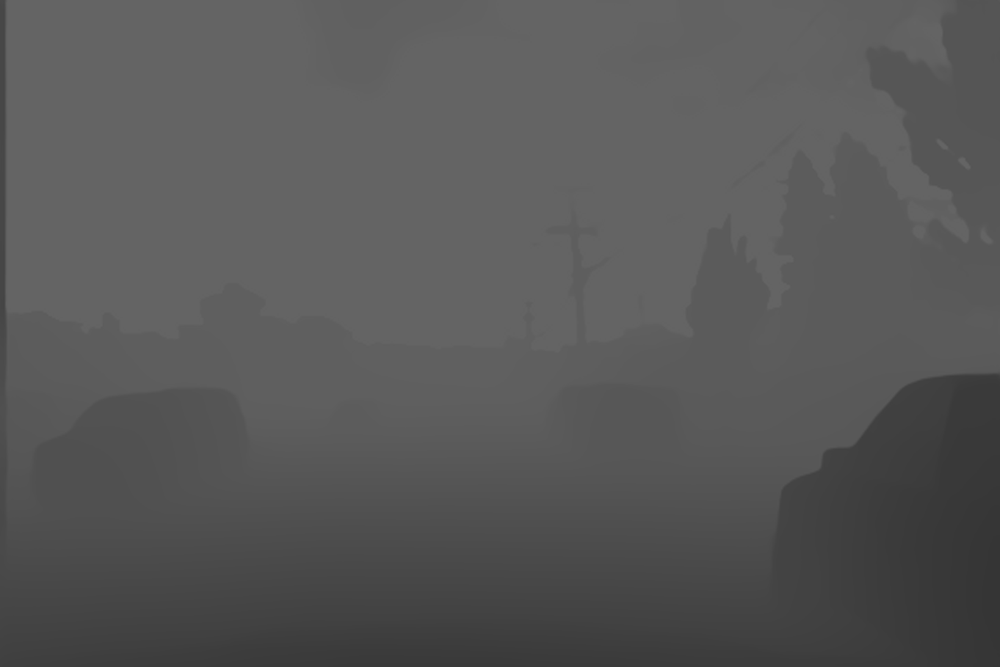

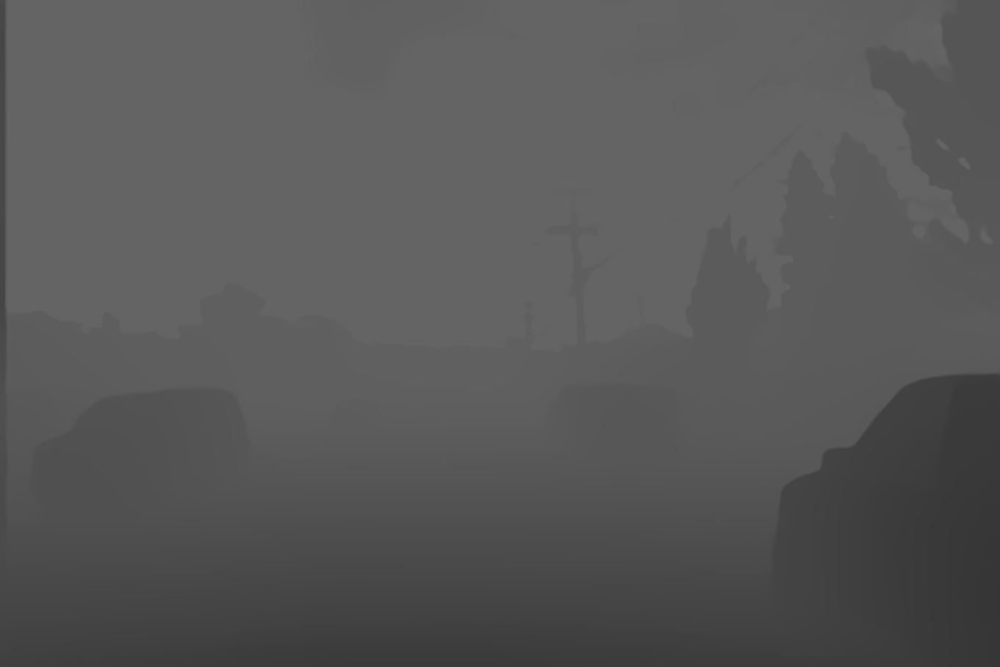

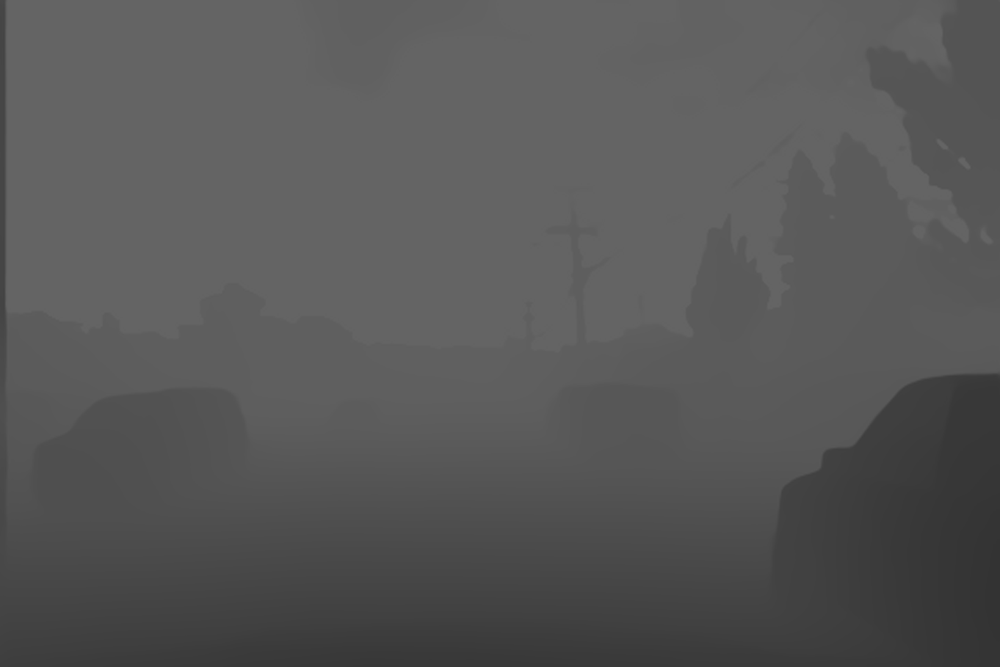

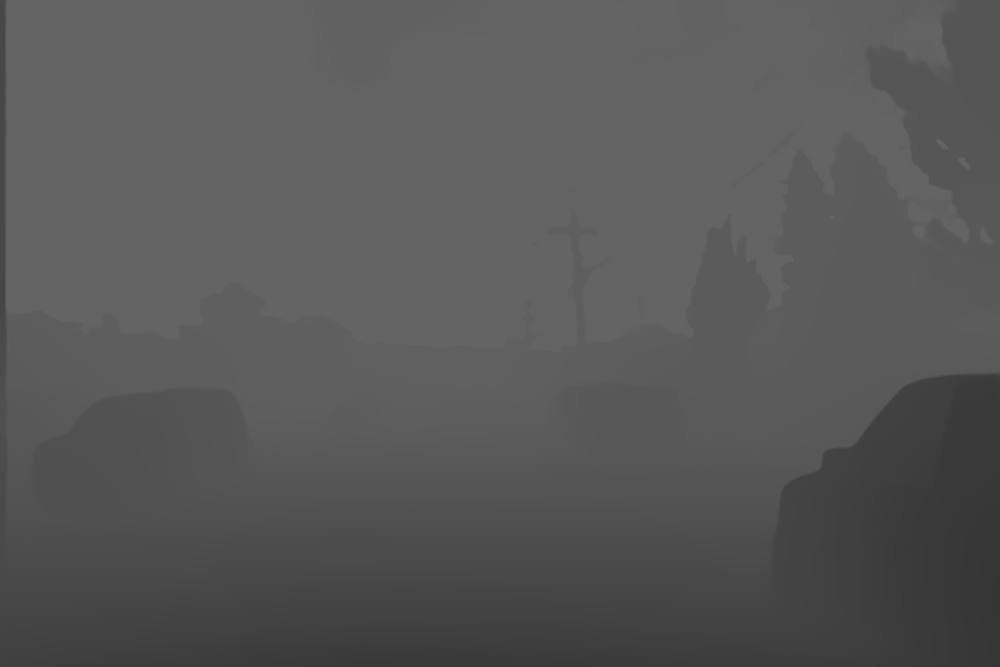

In [ ]:
# read until end of video
while(cap.isOpened()):
    # capture each frame of the video
    ret, frame = cap.read()
    if ret == True:
        #segmentation
        original_im = Image.fromarray(frame[..., ::-1])
        seg_map = MODEL.run(original_im)
        seg_image = label_to_color_image(seg_map).astype(np.uint8)

        #depth pred
        img = frame
        img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

        input_batch = transform(img).to(device)

        with torch.no_grad():
          prediction = midas(input_batch)

          prediction = torch.nn.functional.interpolate(
            prediction.unsqueeze(1),
            size=img.shape[:2],
            mode="bicubic",
            align_corners=False,
          ).squeeze()
        
        depth_out = prediction.cpu().numpy()
        depth_out=45*output/np.max(depth_out)     #normalization due to the 
        depth_out=f(depth_out)
        #print(depth_out)

        # add gaussian blurring to frame
        frame = cv2.GaussianBlur(frame, (5, 5), 0)
        #print(frame)

        # save video frame
        #out.write(depth_out)

        # display frame
        #plt.imshow(depth_out, cmap='plasma')
        cv2_imshow(depth_out)
        # press `q` to exit
        if cv2.waitKey(27) & 0xFF == ord('q'):
            break
    # if no frame found
    else:
        break
# release VideoCapture()
cap.release()
# close all frames and video windows
cv2.destroyAllWindows()